In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
from fastai.basics import *

In [3]:
n=100
x = torch.ones(n,2)
x[:,0].uniform_(-1.,1)
x[:5]

tensor([[-0.2901,  1.0000],
        [-0.2544,  1.0000],
        [ 0.1359,  1.0000],
        [-0.9813,  1.0000],
        [-0.1176,  1.0000]])

In [52]:
a_correct = tensor(-1.,2)
y = x@a_correct + torch.rand(n)

In [53]:
a = tensor(-4.,-4)

In [54]:
y_hat = x@a

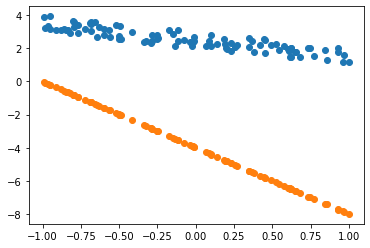

In [55]:
plt.scatter(x[:,0], y)
plt.scatter(x[:,0], y_hat)

In [56]:
def loss_func(a):
    y_hat = x@a
    return ((y_hat - y)**2).mean()

In [57]:
loss_func(a_correct)

tensor(0.2916)

In [58]:
a1 = torch.linspace(-5,5, 90)
a2 = torch.linspace(-5,5, 90)
X,Y = torch.meshgrid(a1,a2)
X1 = X.reshape(1,-1)
Y1 = Y.reshape(1,-1)

In [59]:
A = torch.cat((X1,Y1))

In [60]:
z = []
for i in range(8100):
    temp = loss_func(A[:,i]).item()
    z += [temp]
Z = torch.tensor(z)

In [61]:
X = X.reshape(90,90).numpy()
Y = Y.reshape(90,90).numpy()
Z = Z.reshape(90,90).numpy()

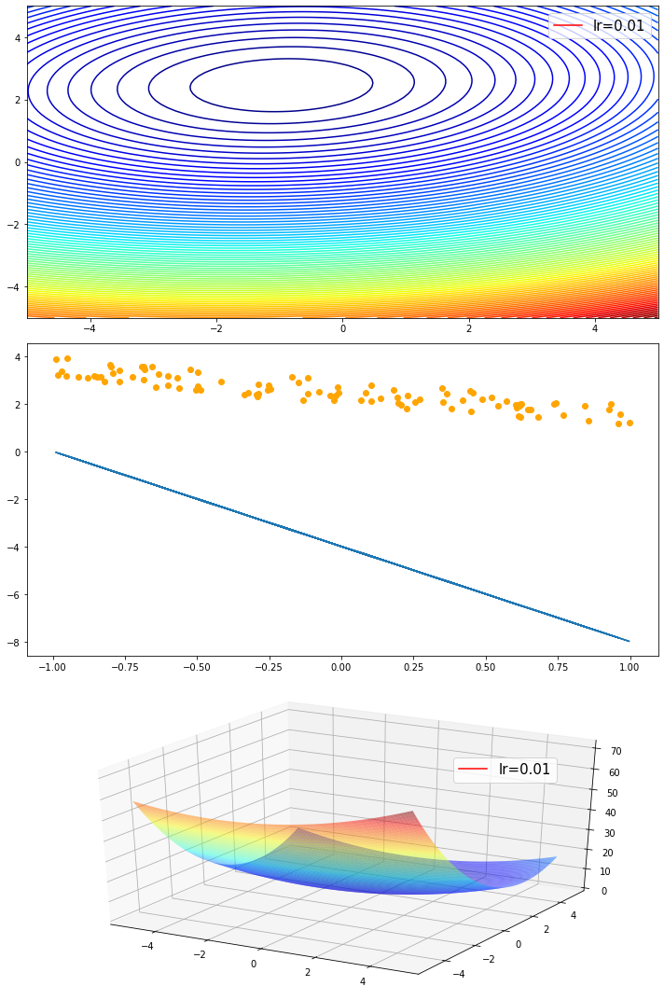

In [91]:
fig = plt.figure(figsize = (10,15))
ax1 = fig.add_subplot(3,1,1)
ax2 = fig.add_subplot(3,1,2)
ax3 = fig.add_subplot(3,1,3, projection = '3d')
point3, = ax3.plot([],[],[] ,'*', color = 'r', markersize = 4)
line3, = ax3.plot([],[],[],'r-', label = 'lr=0.01', lw = 1.5)
ax3.plot_surface(X,Y,Z,rstride=1, cstride=1, cmap='jet', edgecolor='none', alpha = 0.5)
ax3.legend(loc=1, fontsize = 15, bbox_to_anchor=(0.85,0.78))
ax1.contour(X,Y,Z,100,cmap = 'jet')
point1, = ax1.plot([],[],'*', color = 'r', markersize = 4)
line1, = ax1.plot([],[],'r-', label = 'lr=0.01', lw = 1.5)
ax1.legend(loc=1,fontsize = 15)
ax2.scatter(x[:,0],y,c='orange')
line2, = ax2.plot(x[:,0],y_hat)
fig.tight_layout()
plt.show()

In [15]:
minval = loss_func(tensor(-1.,2))

In [16]:
def mse(y, y_hat): return ((y_hat - y)**2).mean()

In [101]:
def update(lr, t):
    i = t % 100
    y_hat = x@a
    k=a.clone().detach().numpy()
    loss = mse(y, y_hat)
    if t%100 == 0:
        print(loss)
    loss.backward()
    with torch.no_grad():
        a.sub_(lr * a.grad)
        a.grad.zero_()
    return k[0], k[1], loss.item()

In [102]:
a = tensor(-4.,-4)
a = nn.Parameter(a)
lr=0.1

In [103]:
x_list,y_list,z_list = [],[],[]
def animate(id):
    x_new,y_new,z_new = update(lr,id)
    x_list.append(x_new)
    y_list.append(y_new)
    z_list.append(z_new)
    line1.set_data(x_list[:id],y_list[:id])
    point1.set_data(x_new, y_new)
    with torch.no_grad():
        line2.set_ydata(x@a)
    line3.set_data(x_list[:id],y_list[:id])
    line3.set_3d_properties(z_list[:id])
    point3.set_data(x_new, y_new)
    point3.set_3d_properties(z_new)
    return line1, point1, line2, line3, point3

In [104]:
from matplotlib import animation, rc
rc('animation', html='jshtml')
anim1 = animation.FuncAnimation(fig, animate, np.arange(800), interval = 100)

In [105]:
anim1.save('sgd_1.gif', fps = 15, writer ='imagemagick')

tensor(43.0881, grad_fn=<MeanBackward0>)
tensor(28.5130, grad_fn=<MeanBackward0>)
tensor(0.0817, grad_fn=<MeanBackward0>)
tensor(0.0817, grad_fn=<MeanBackward0>)
tensor(0.0817, grad_fn=<MeanBackward0>)
tensor(0.0817, grad_fn=<MeanBackward0>)
tensor(0.0817, grad_fn=<MeanBackward0>)
tensor(0.0817, grad_fn=<MeanBackward0>)
tensor(0.0817, grad_fn=<MeanBackward0>)


In [106]:
anim1

tensor(0.0817, grad_fn=<MeanBackward0>)
tensor(0.0817, grad_fn=<MeanBackward0>)


Animation size has reached 21345491 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


tensor(0.0817, grad_fn=<MeanBackward0>)
tensor(0.0817, grad_fn=<MeanBackward0>)
tensor(0.0817, grad_fn=<MeanBackward0>)
tensor(0.0817, grad_fn=<MeanBackward0>)
tensor(0.0817, grad_fn=<MeanBackward0>)
tensor(0.0817, grad_fn=<MeanBackward0>)
tensor(0.0817, grad_fn=<MeanBackward0>)


# Adam

In [ ]:
def update_adam(lr,t):
    i = t % 100
    y_hat = x[i]@a
    k = a.clone()
    opt = optim.Adam([a], lr)
    loss = mse(y[i], y_hat)
    loss.backward()
    if t % 100 == 0:
        print(loss)
    opt.step()
    opt.zero_grad()
    return loss.item(), k.detach().numpy()

In [ ]:
lr = 0.8
a= tensor(-4.,-4)
a = nn.Parameter(a)
losses_adam = [update_adam(lr,t) for t in range(2000)]

In [ ]:
lr = 0.2
a= tensor(-4.,-4)
a = nn.Parameter(a)
losses_adam_low = [update_adam(lr,t) for t in range(2500)]

In [ ]:
losses_adam[:5], losses[:5]

In [ ]:
points_list_1 = [loss[1] for loss in losses_1]
points_list_2 = [loss[1] for loss in losses_2]
points_list_3 = [loss[1] for loss in losses_3]
points_list_4 = [loss[1] for loss in losses_4]
points_list_5 = [loss[1] for loss in losses_5]
points_list_6 = [loss[1] for loss in losses_6]

In [ ]:
points_list[:5], points_list_a[:5]

In [ ]:
from matplotlib import animation, rc
rc('animation', html='jshtml')

In [ ]:
from IPython.display import HTML
anim1 = animation.FuncAnimation(fig, animate, np.arange(len(points_list)), interval = 20)
HTML(anim1.to_jshtml())

In [ ]:
# Set up formatting for the movie files
Writer = animation.writers['ffmpeg']
writer = Writer(fps=30, metadata=dict(artist='Me'), bitrate=1800)

In [ ]:
anim1.save('sgdvisual.mp4', fps = 30, writer ='ImageMagick')

In [ ]:
import ipywidgets as widgets
widgets.FloatSlider(
    value=0.3,
    min=0.01,
    max=2.0,
    step=0.1,
    description='Learning rate',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='.1f',
)